<a href="https://colab.research.google.com/github/mohamadFikry/PCVK/blob/main/week3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Mengubah tingkat kecerahan citra
--------------------------------
Masukan nilai kecerahan:50


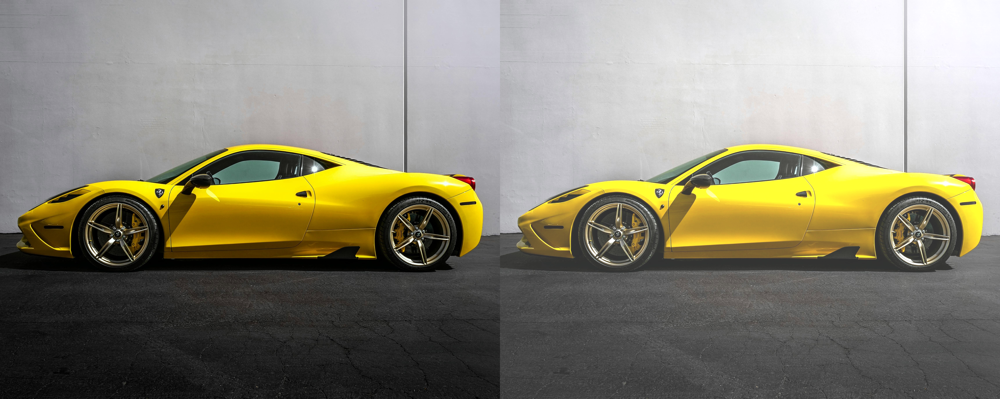

In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow
from skimage import io
import matplotlib.pyplot as plt
import numpy as np

print('Mengubah tingkat kecerahan citra')
print('--------------------------------')
try:
  brightness = int(input('Masukan nilai kecerahan:'))
except ValueError: print('Error, not a number')

original = cv.imread('/content/drive/MyDrive/pexels-lynxexotics-3954422.jpg')
brightness_image = np.zeros(original.shape, original.dtype)

#akses per piksel
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]): brightness_image[y,x,c] = np.clip(original[y,x,c] + brightness, 0, 255)

#cara simpel tanpa for loop
#brightness_image = cv.convertScaleAbs(original, beta=brightness)
final_frame = cv.hconcat((original, brightness_image))

cv2_imshow(final_frame)

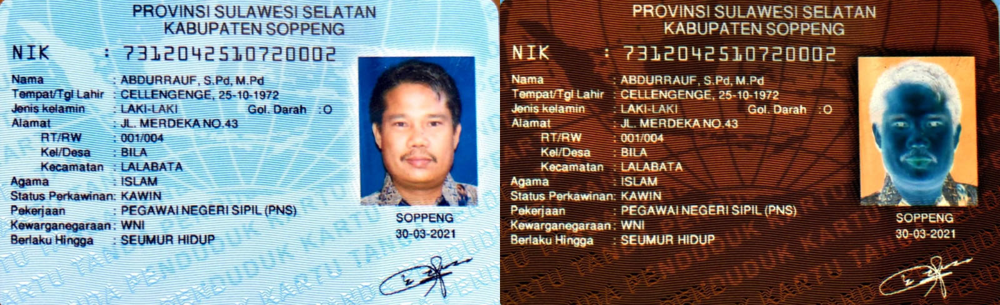

In [ ]:
img = io.imread('https://bimamedia-gurusiana.ap-south-1.linodeobjects.com/099fe6b0b444c23836c4a5d07346082b/2021/04/20/l-img20210420015823jpg20210420005933.jpeg')
img = cv.cvtColor(img, cv.COLOR_RGB2BGR)

#menginversi gambar
img_inversed = cv.bitwise_not(img)
final = cv.hconcat((img, img_inversed))
cv2_imshow(final)

Mengubah kontras dan tingkat kecerahan citra
--------------------------------------------
Masukan nilai kecerahan [-255 - 255]: 50
Masukan nilai kontras [1.0 - 3.0]: 2


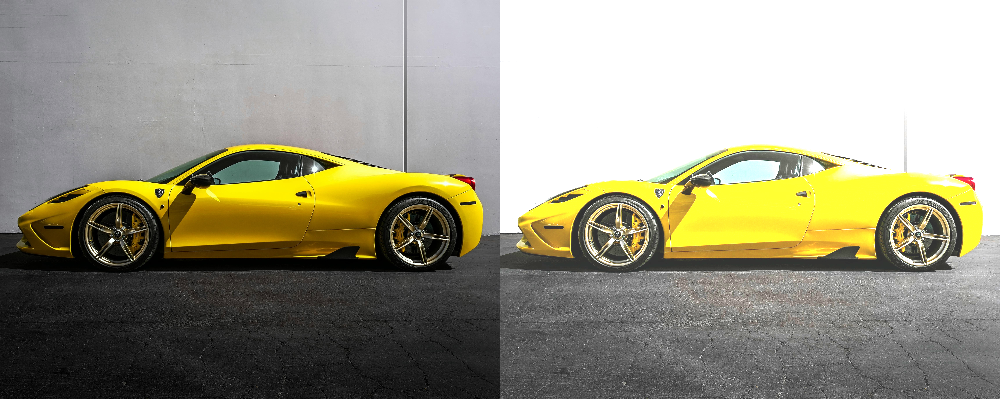

In [ ]:
print('Mengubah kontras dan tingkat kecerahan citra')
print('--------------------------------------------')
try:
  brightness = int(input('Masukan nilai kecerahan [-255 - 255]: '))
  contrast = float(input('Masukan nilai kontras [1.0 - 3.0]: '))
except ValueError:
  print('Error, not a number')

original = cv.imread('/content/drive/MyDrive/pexels-lynxexotics-3954422.jpg')
# Menginisiasi array kosong dengan ukuran dan tipe yang sama dengan citra asli
image = np.zeros(original.shape, original.dtype)
# Menerapkan transformasi kecerahan dan kontras
image = cv.convertScaleAbs(original, alpha=contrast, beta=brightness)
c_image = cv.hconcat((original, image))
cv2_imshow(c_image)

Mengubah tingkat kecerahan citra dengan Transformasi Log
--------------------------------------------------------------
Masukan faktor kecerahan ): 50


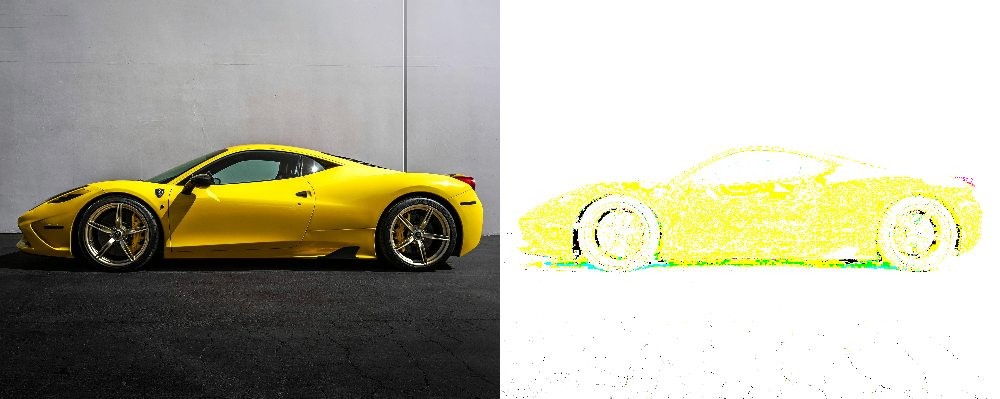

In [ ]:
print('Mengubah tingkat kecerahan citra dengan Transformasi Log')
print('--------------------------------------------------------------')

try:
    brightness_factor = float(input('Masukan faktor kecerahan ): '))
except ValueError:
    print('Error, not a number')

original = cv.imread('/content/drive/MyDrive/pexels-lynxexotics-3954422.jpg')

# Konversi citra ke tipe float32 agar lebih presisi dalam transformasi log
original_float = original.astype(np.float32)

# Transformasi logaritmik dengan faktor kecerahan
c = (255 / np.log(1 + np.max(original_float))) * brightness_factor  # konstanta skala dengan faktor kecerahan
log_image = c * np.log(1 + original_float)

# Normalisasi nilai piksel ke rentang [0, 255] dan konversi ke tipe uint8
log_image = np.clip(log_image, 0, 255).astype(np.uint8)

final_fr = cv.hconcat((original, log_image))
cv2_imshow(final_fr)